# IMBD 2022 - Project B EDA

## About Project B
Given processing information (*i.e.*, `n_sg.csv` (伺服資訊，以1000Hz採樣) and `n_spike.csv` (智慧刀把資訊，以2500Hz採樣), where `n` is the indicator of layers) of target knives, the objective is to predict the **maximal flank wear (刀腹摩耗最大值) `MaxWear`** after each processing stage (layer). There are 3 knives in total (`train1` is the first one with **46** layers of processing, `train2` is the second one with **24** layers and tje last `test` with **25**). Last but not the least, the evaluation metric is **RMSE**.
> `train2` and `test` will be provided on 11/19 and `test` won't contain `MaxWear`.

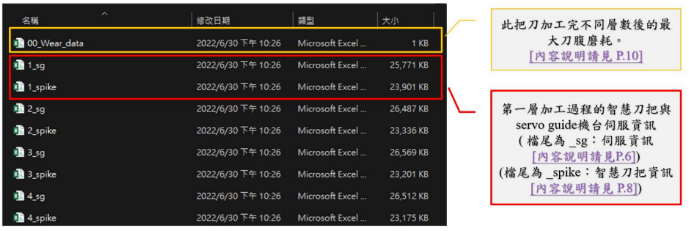
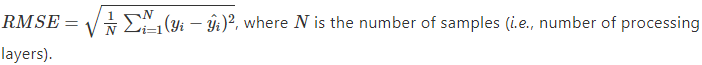

<div class="alert alert-danger">
    <h5><code>MaxWear</code> is cumulative. However, it's <strong>not</strong> monotonically increasing, indicating that wear can be positive or negative</h5>
</div>

> 總之，幾層就是對應幾筆資料就是了。

> 感覺先處理成當成摩耗增減，再層層做累加比較合理。

> pdf應該是給到train2答案，可以協助確認一下unseen的wear分布是否相似。此外，需注意train2和test的層數非常接近!!!

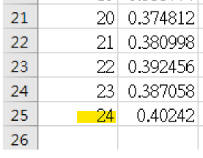

> 最終，當天答案需要填入`projectB_ans.xlsx` (順序需要特別注意)，書面一樣列入評分.

|  | **金獎資格** | **銀獎資格** |
| -------- | -------- | -------- |
| RMSE     | **< 0.049**     | **< 0.059**    |

## About this Notebook
In this kernel, we will do exploratory data analysis on processing information `spike.parquet` and `sg.spike`. Also, the target `wear.csv` will be explored.

<a id="toc"></a>
## Table of Contents 
* [1. Downcast is All You Need](#downcast)
* [2. `train.xlsx`](#train)
    * *[File Description](#file_desc)*
    * *[Simple Summary](#simple_sum)*
    * *[Primary Key](#pk)*
    * *[Feature Exploration](#feat)*
    * *[Target Exploration](#target)*

<div class="alert alert-danger">
    <h5>打上星號⭐為較重要的章節，內含決定性的發現以及分析過程。</h5>
</div>

## Import Packages

In [54]:
%load_ext autoreload
%autoreload 2
import os
import gc
import sys
import warnings
sys.path.append("../")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
from tqdm import tqdm

from utils.eda import *
import metadata

# Configuration
warnings.simplefilter("ignore")
pd.options.display.max_rows = None
pd.options.display.max_columns = None
sns.set_style("darkgrid")
colors = sns.color_palette("Set2")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Load Data

As always, let's load data first.

In [2]:
%%time

RAW_DATA_PATH = "../data/raw/projectB/"
PROC_DATA_PATH = "../data/processed/projectB/"
sg = pd.read_parquet(os.path.join(PROC_DATA_PATH, "sg.parquet"))
spike = pd.read_parquet(os.path.join(PROC_DATA_PATH, "spike.parquet"))
wear = pd.read_csv(os.path.join(RAW_DATA_PATH, "wear.csv"))

CPU times: user 2.8 s, sys: 1.47 s, total: 4.27 s
Wall time: 1.32 s


In [55]:
# Define metadata of this project
METADATA = metadata.B
METADATA

{'PK': ['time', 'layer'],
 'FEAT': ['b', 'c', 'd', 'e', 'f', 'g', 'h', 'i'],
 'TARGET': 'MaxWear',
 'PROC_LAYERS': 46}

## 1. Downcast is All You Need
[**<span style="color:#FEF1FE; background-color:#535d70;border-radius: 5px; padding: 2px">Go to Table of Content</span>**](#toc)

### If downcasting is done and the corresponding files are dumped, please skip this section.

**Downcasting** is a technique to reduce the numeric precision for better **RAM-efficiency** and lower time cost to process, analyze and visualize the data. And, it's a good starting point for EDA with large amount of data (*i.e.*, number of rows is large in this project (> 10 millions)). Hence, let's convert dtypes now. However, downcasting `A` column (time information) for `spike` leads to severe information loss, so we keep the original precision of `A`.

<div class="alert alert-danger">
    <h5>To obtain high-quality prediction, we may need to go back to use the original data with higher precision for modeling. But, the effectiveness remains unknown now.</h5>
</div>

> 只有建模可以告訴我們精度是否會對建模成效產生決定性影響。

In [4]:
def save_mem(df: pd.DataFrame) -> pd.DataFrame:
    """Apply some techniques to save RAM usage of data.
    
    Downcasting time column for spike seems harmful.
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print(f"Memory usage of dataframe is {start_mem:.2f} MB")
    
    df = _convert_filename_to_layer(df)
    feat_cols = [c for c in df.columns if c not in ["A", "layer"]]
    df = df.rename({
        "A": "time", 
        **{c: c.lower() for c in feat_cols}
    }, axis=1)
    feat_cols = list(map(lambda col: col.lower(), feat_cols))
    dc_cols = feat_cols# + ["time"]   # Columns to downcast
    df[dc_cols] = df[dc_cols].astype(np.float32)  # From 8 bytes to 4
    if "i" in df:
        df["i"] = df["i"].astype(np.int16)
    
    end_mem = df.memory_usage().sum() / 1024**2
    print(f"Memory usage after downcasting is: {end_mem:.2f} MB")
    print(f"Decreased by {100 * (start_mem - end_mem) / start_mem:.1f}%:")
    
    return df

def _convert_filename_to_layer(df: pd.DataFrame) -> pd.DataFrame:
    """Convert `file_name` column to layer indicator.
    
    Note that the dtype of `Index` column in `wear.csv` is `np.int64`.
    Also see: https://stackoverflow.com/questions/52259631/
    """
    df["layer"] = df["file_name"].str.split("_").str[0].astype(np.int8)
    df = df.drop("file_name", axis=1)
    
    return df

In [5]:
sg = save_mem(sg)
summarize(sg)
sg.info()
sg.to_parquet("../data/processed/projectB/sg.parquet", index=False)

Memory usage of dataframe is 1258.55 MB
Memory usage after downcasting is: 613.54 MB
Decreased by 51.2%:
=====Summary of Data=====


,time,b,c,d,e,f,g,h,i,layer
0,0.000,-189.537003,-2.046141,-218.080994,-1.730294,-74.046997,13.141994,1.422119,1061,1
1,0.001,-189.533997,-2.128536,-218.076996,-2.156001,-74.046997,13.155726,1.403809,1060,1
2,0.002,-189.529999,-2.087339,-218.074005,-2.334523,-74.049004,13.155726,1.397705,1061,1
3,0.003,-189.526001,-1.963746,-218.070007,-2.595441,-74.047997,13.128262,1.159668,1060,1
4,0.004,-189.522003,-2.032409,-218.065994,-2.952486,-74.047997,13.128262,1.086426,1061,1


Shape: (16496046, 10)
NaN ratio:


,time,b,c,d,e,f,g,h,i,layer
NaN Ratio,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Zero ratio:


,c,b,e,time,d,f,g,h,i,layer
Zero Ratio,0.034608,0.018932,0.00916,0.000279,0.000055,0.0,0.0,0.0,0.0,0.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16496046 entries, 0 to 16496045
Data columns (total 10 columns):
 #   Column  Dtype  
---  ------  -----  
 0   time    float64
 1   b       float32
 2   c       float32
 3   d       float32
 4   e       float32
 5   f       float32
 6   g       float32
 7   h       float32
 8   i       int16  
 9   layer   int8   
dtypes: float32(7), float64(1), int16(1), int8(1)
memory usage: 613.5 MB


In [7]:
spike = save_mem(spike)
summarize(spike)
spike.info()
spike.to_parquet("../data/processed/projectB/spike.parquet", index=False)

Memory usage of dataframe is 1573.18 MB
Memory usage after downcasting is: 825.92 MB
Decreased by 47.5%:
=====Summary of Data=====


,time,b,c,d,layer
0,0.0000,24.921879,-9.475802,0.833795,1
1,0.0004,28.295334,-12.450098,1.509845,1
2,0.0008,30.417959,-14.509226,0.878865,1
3,0.0012,30.796999,-17.292862,2.952085,1
4,0.0016,31.555079,-18.627481,3.132365,1


Shape: (41240046, 5)
NaN ratio:


,time,b,c,d,layer
NaN Ratio,0.0,0.0,0.0,0.0,0.0


Zero ratio:


,c,d,b,time,layer
Zero Ratio,0.510686,0.29143,0.206023,0.000112,0.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41240046 entries, 0 to 41240045
Data columns (total 5 columns):
 #   Column  Dtype  
---  ------  -----  
 0   time    float64
 1   b       float32
 2   c       float32
 3   d       float32
 4   layer   int8   
dtypes: float32(3), float64(1), int8(1)
memory usage: 825.9 MB


## 1. `n_sg` Information
[**<span style="color:#FEF1FE; background-color:#535d70;border-radius: 5px; padding: 2px">Go to Table of Content</span>**](#toc)

<a id="file_desc"></a>
### *File Description*
[**<span style="color:#FEF1FE; background-color:#535d70;border-radius: 5px; padding: 2px">Go to Table of Content</span>**](#toc)

This file contains information about **servo guide**, which is collected with **1000Hz** sampling frequency; that is, there are 1000 samples collected for one second. However, there are some issues needed to be clarified:
<div class="alert alert-warning">
    <ol>
        <li>A欄時間資訊 (sec)是連續採樣的結果嗎，是否存在中間有空缺的現象?</li>
        <li>各加工層間隔時間固定嗎，還是有一定規律可循?</li>
    </ol>
</div>

<a id="simple_sum"></a>
### *Simple Summary*
[**<span style="color:#FEF1FE; background-color:#535d70;border-radius: 5px; padding: 2px">Go to Table of Content</span>**](#toc)

First of all, `sg` information has 8 features in total (*i.e.*, `b` to `i`). And, there exists no `NaN` in this dataset. Furthermore, the number of samples seems larger than all the datasets we process before (about **16.5 million** rows); hence, how to efficiently process, analyze and use this dataset is a challenge.<br>
Second, **zero values** exist in some features. Therefore, we will explore how zero pattern bahaves in the following section. 

In [4]:
summarize(sg, "sg", 3)

=====Summary of sg=====


,time,b,c,d,e,f,g,h,i,layer
0,0.000,-189.537003,-2.046141,-218.080994,-1.730294,-74.046997,13.141994,1.422119,1061,1
1,0.001,-189.533997,-2.128536,-218.076996,-2.156001,-74.046997,13.155726,1.403809,1060,1
2,0.002,-189.529999,-2.087339,-218.074005,-2.334523,-74.049004,13.155726,1.397705,1061,1


Shape: (16496046, 10)
NaN ratio:


,time,b,c,d,e,f,g,h,i,layer
NaN Ratio,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Zero ratio:


,c,b,e,time,d,f,g,h,i,layer
Zero Ratio,0.034608,0.018932,0.00916,0.000279,0.000055,0.0,0.0,0.0,0.0,0.0


<a id="pk"></a>
### *Primary Key*
[**<span style="color:#FEF1FE; background-color:#535d70;border-radius: 5px; padding: 2px">Go to Table of Content</span>**](#toc)

Each sample can be uniquely identified with its `(layer, time)` pair. That is, one row represents the `sg` information at `time` second in that `layer`.

In [5]:
assert sg.groupby("layer")["time"].nunique().sum() == len(sg), (
    "There are duplicated (layer, time) pairs, violating PK definition!!!"
)
assert sg["layer"].nunique() == METADATA["PROC_LAYERS"], (
    "Number of processing layers isn't properly set."
)

Each processing layer either has **416001** or **284001** samples, which is demarcated by the boundary between layer **26** and **27**.

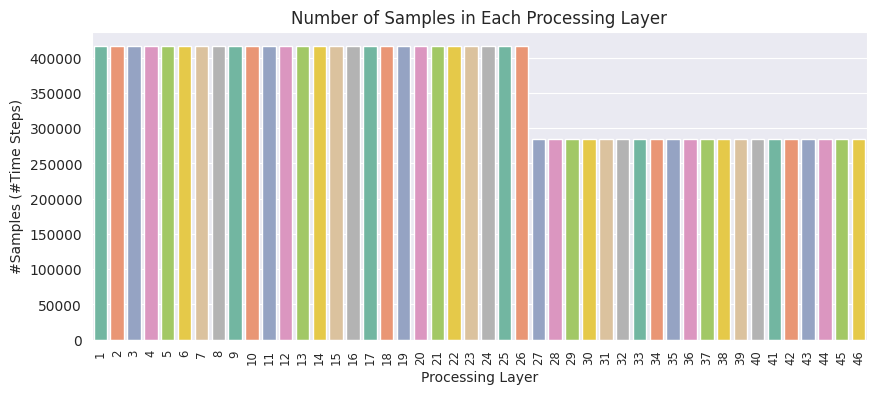

Unique number of samples per layer: [416001 284001]


In [6]:
n_samples_per_layer = sg.groupby("layer")["time"].nunique()
n_samples_per_layer_uniq = n_samples_per_layer.unique()

fig, ax = plt.subplots(figsize=(10, 4))
sns.barplot(x=n_samples_per_layer.index, y=n_samples_per_layer.values, palette=colors, ax=ax)
ax.set_title("Number of Samples in Each Processing Layer")
ax.set_xlabel("Processing Layer")
ax.tick_params(axis='x', rotation=90, labelsize="small")
ax.set_ylabel("#Samples (#Time Steps)")
plt.show()
print(f"Unique number of samples per layer: {n_samples_per_layer_uniq}")

All rows are sampled at the unique **416001** time steps.

In [7]:
assert sg.time.nunique() == 416001, (
    "There are rows sampled from unique time steps outside the largest interval."
)

All samples from layer 27 to 46 are collected at the same time steps.

In [8]:
pk_deep_l = sg[sg["layer"].isin([l for l in range(27, 47)])][METADATA["PK"]]
sg_t_deep_l = np.array(list(pk_deep_l.groupby("layer")["time"].unique()))  # Shape is a little bit tricky if not converted to list first...
assert not (~np.equal(sg_t_deep_l[0], sg_t_deep_l)).any(), (
    "Sampling time steps are different in deep layers (from 27 to 46)."
)

<a id="pk"></a>
### *Feature Exploration*
[**<span style="color:#FEF1FE; background-color:#535d70;border-radius: 5px; padding: 2px">Go to Table of Content</span>**](#toc)

First, univariate features distributions are observed separately without considering any grouping factors, like **time step** and **layer**. Following are some preliminary insights about each feature:
* `B`
    * It has some **uniformly distributed** regions which behaves like **separated plateaus**.
    * A **long tail** exists from about value 20 to maximum.
    * **Outlier** issue should be well handled.
    * There are interesting peaks whose bin counts are far larger than others'.
* `C`
    * **Multi-modality** exists.
    * Bin counts show insiginificant periodic fluctuation.
        > 類似平滑分布代帶有尖刺。
* `D`
    * Values seem to be divided into two groups.
    * There are interesting peaks whose bin counts are far larger than others'.
* `E`
    * The distribution is **bi-modal** and **symmetric**.
* `F`
    * Some value intervals seem to be skipped.
        > 可以觀察是否有**離散**特性。
    * Value gaps are not equally spaced.
* `G`
    * Some value intervals seem to be skipped.
        > 可以觀察是否有**離散**特性。
    * Value gaps seem to be **equally spaced**.
* `H`
    * Bin counts show siginificant **periodic fluctuation**.
        > 類似平滑分布代帶有尖刺，較`C`明顯。
* `I`
    * The only one **integer** feature.
    * **Discrete** property is shown.
        > 不確定`train2`和`test`會不會有OOV。


<div class="alert alert-danger">
    <h5>這邊視覺化的資料是<strong>降精度</strong>過的，所以對於<strong>離散以及連續</strong>的解讀必須特別留意。</h5>
</div>

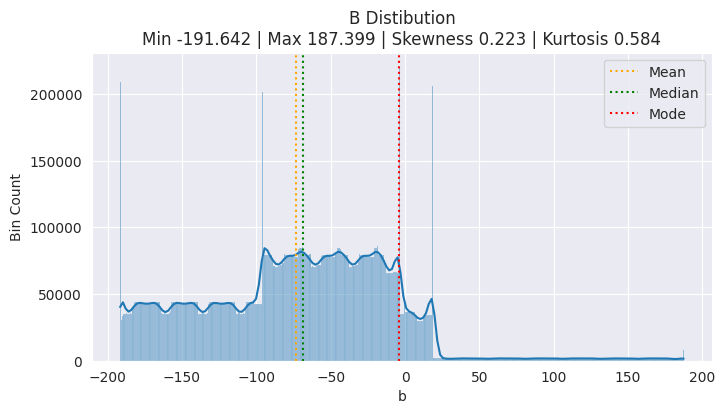

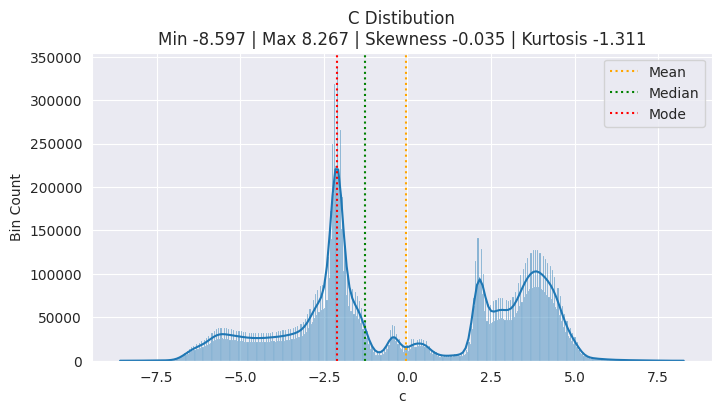

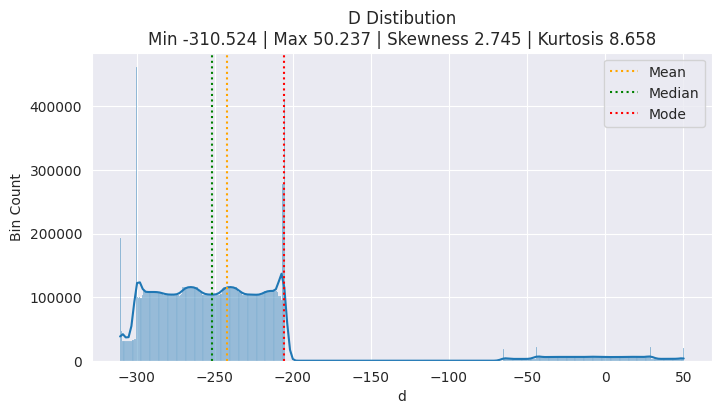

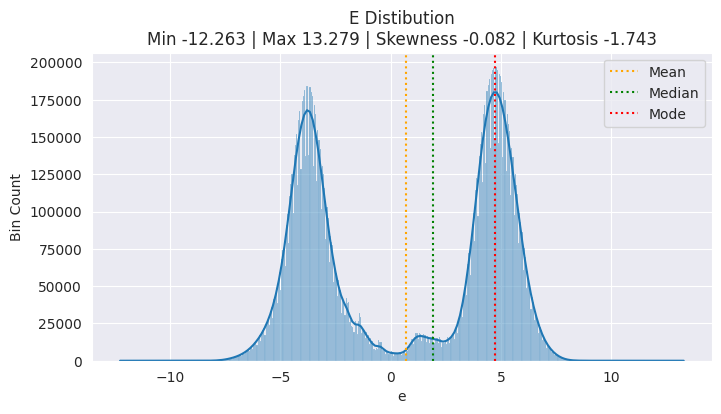

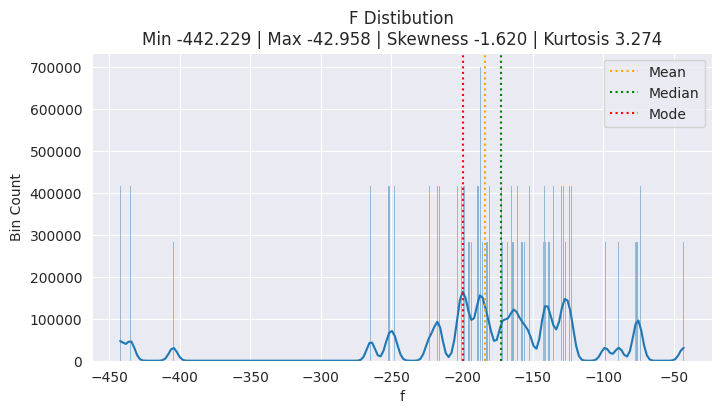

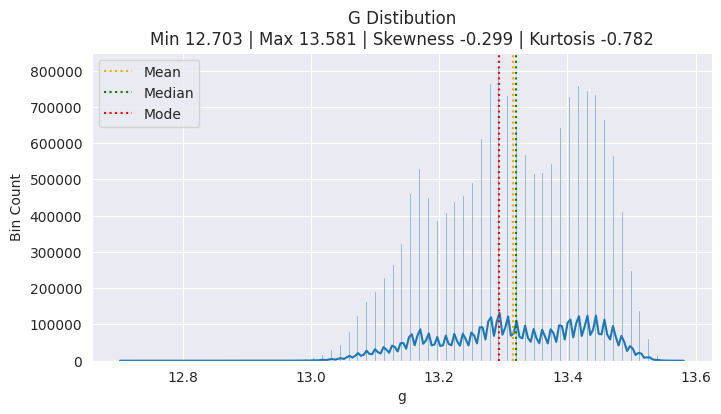

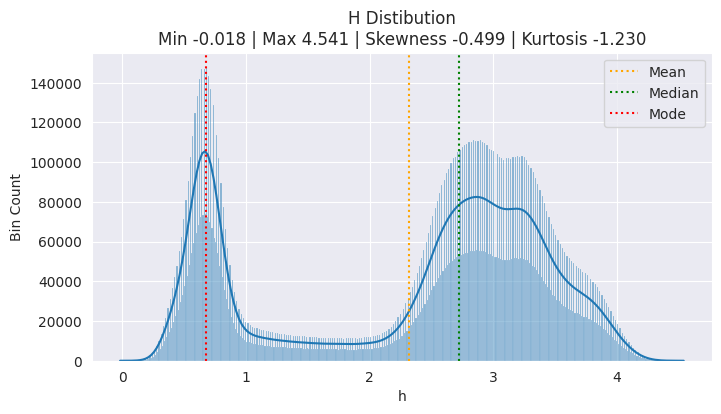

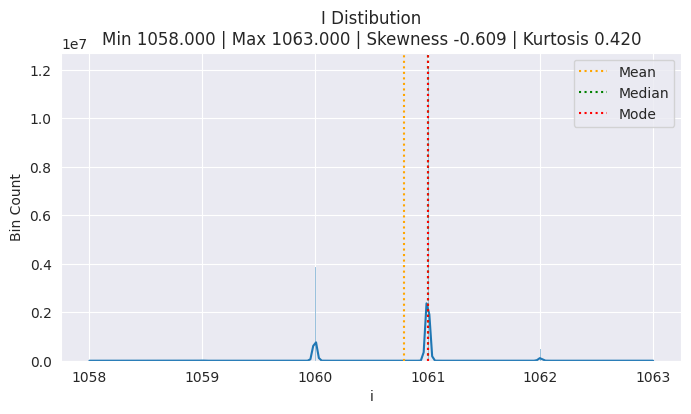

In [9]:
for col in [c for c in sg.columns if c not in METADATA["PK"]]:
    plot_univar_dist(sg[col], col, 500)

Then, feature distributions can also be analyzed from **layer-wise** perspective. We can observe some **cross-layer** properties, which are summarized as follows:
* `B`
    * hihi
* `C`
* `D`
* `E`
* `F`
* `G`
* `H`
* `I`

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8/8 [08:07<00:00, 60.99s/it]


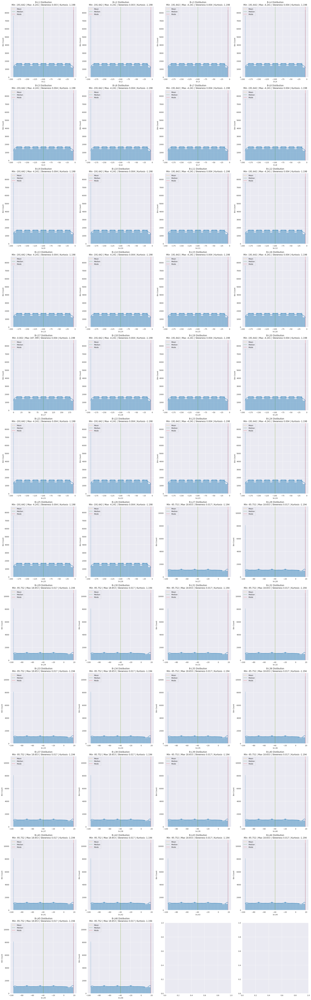

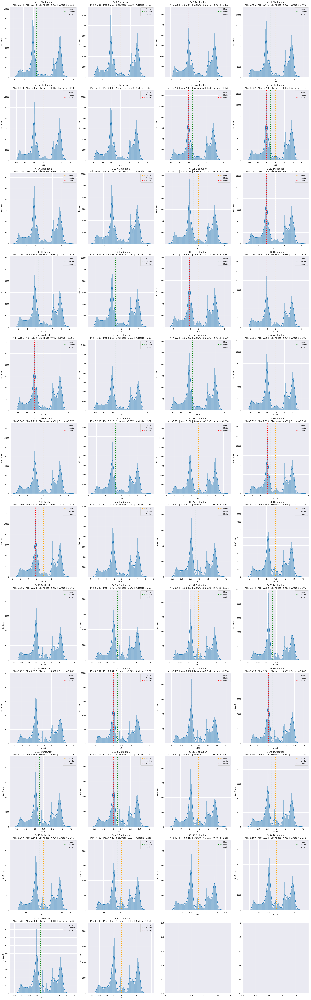

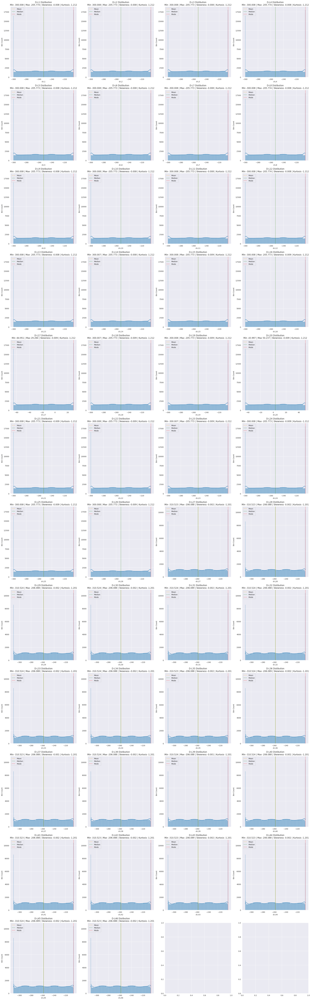

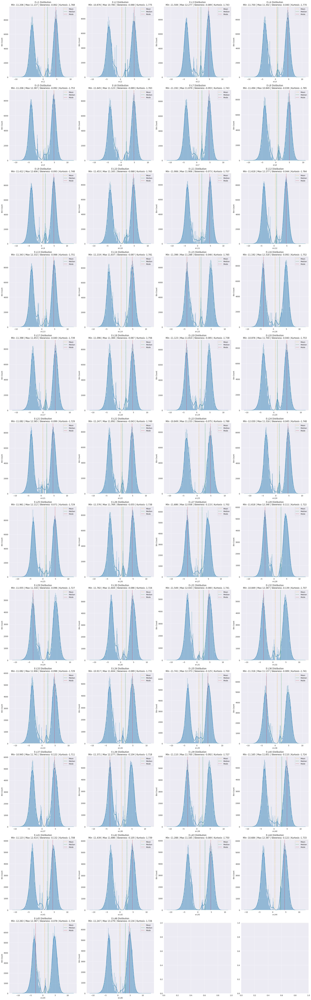

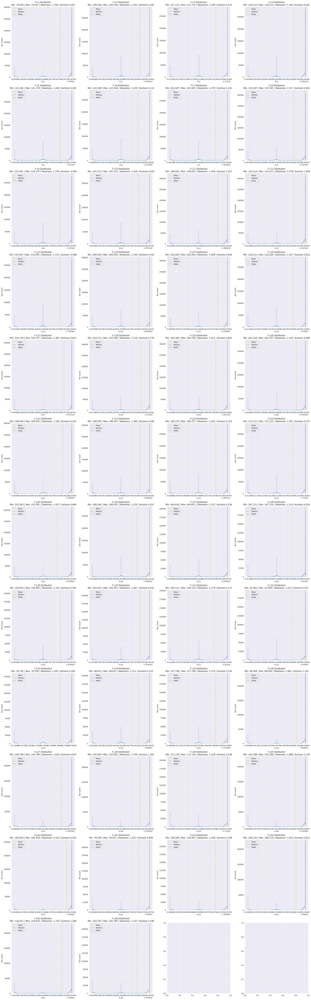

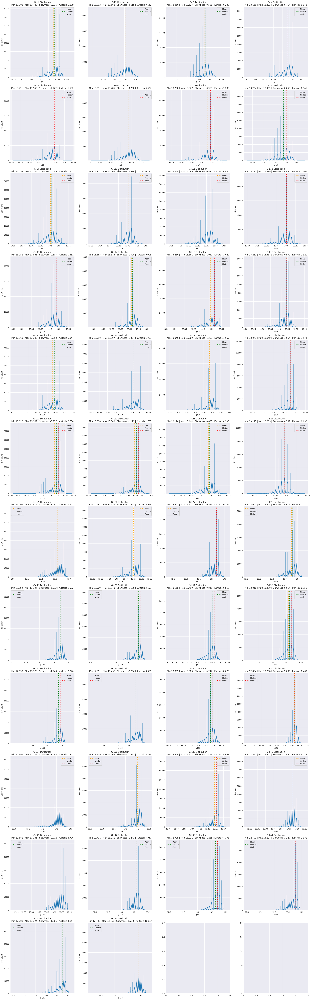

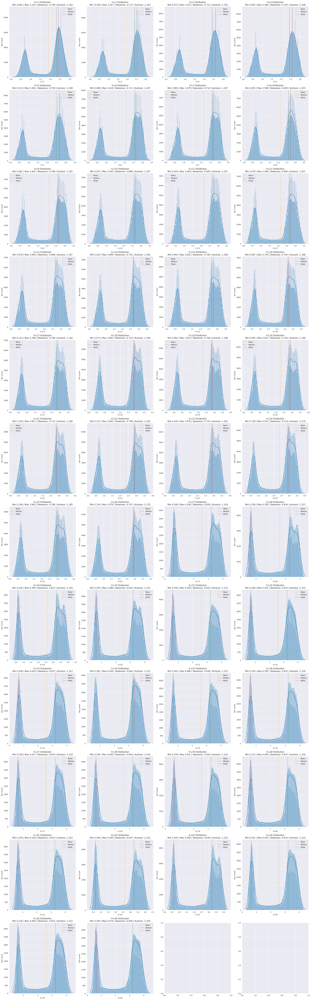

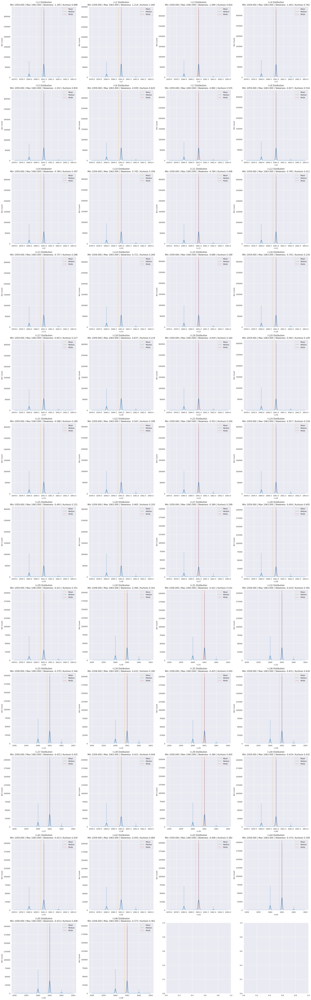

In [56]:
sg_layer_gp = sg.groupby("layer")

for feat in tqdm(METADATA["FEAT"]):
    fig, axes = plt.subplots(figsize=(25, 80), nrows=12, ncols=4)
    for i, (l, gp) in enumerate(sg_layer_gp):
        plot_univar_dist(gp[feat], f"{feat}-L{l}", ax=axes[i//4, i%4])
    plt.tight_layout()

46it [00:00, 81.38it/s]


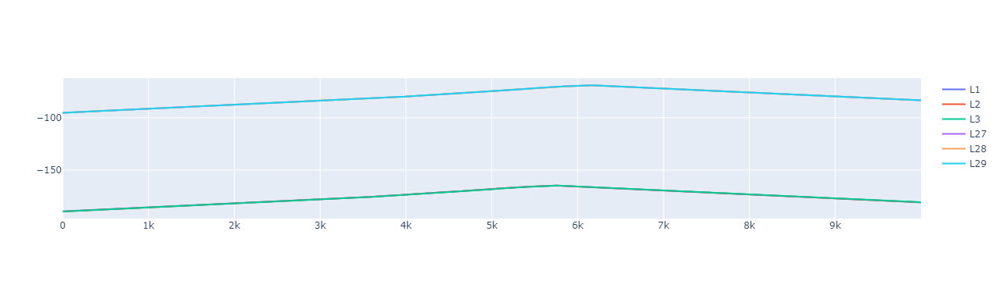

In [60]:
# Observe synchronous trend of feature B
fig = go.Figure()
for i, (l, gp) in tqdm(enumerate(sg_layer_gp)):
    if i not in ([0, 1, 2] + [26, 27, 28]): continue
    gp = gp.reset_index(drop=True)
    fig.add_trace(go.Scatter(x=np.arange(10000), y=gp.loc[:10000, "b"].values, name=f"L{l}"))
fig.show()